In [1]:
import import_ipynb
import Scanpy_functions_v03262021 as sc_pipe
import scvelo as scv
scv.logging.print_version()
import warnings
import scirpy as ir
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import bbknn
import logging
from sklearn.mixture import GaussianMixture
from scipy.stats     import norm
import glob
import os
import hvplot.pandas
import docx
from docx import Document
from docx.shared import Inches
from docx.shared import Pt
from scipy import sparse
import scanpy.external as sce
import holoviews as hv
import panel as pn
import bokeh
from bokeh.resources import INLINE
import scanorama
import gseapy

importing Jupyter notebook from Scanpy_functions_v03262021.ipynb
Running scvelo 0.2.4 (python 3.10.6) on 2023-02-14 10:12.


ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI no longer supports 'pip search' (or XML-RPC search). Please use https://pypi.org/search (via a browser) instead. See https://warehouse.pypa.io/api-reference/xml-rpc.html#deprecated-methods for more information.


Running scvelo 0.2.4 (python 3.10.6) on 2023-02-14 10:12.


ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI no longer supports 'pip search' (or XML-RPC search). Please use https://pypi.org/search (via a browser) instead. See https://warehouse.pypa.io/api-reference/xml-rpc.html#deprecated-methods for more information.


In [2]:
# define sample metadata. Usually read from a file.
exclude_genes = []

samples = {
'GA23428':{},
'GA23429':{},
'GA18593':{},
'GA18594':{},
'GA11556':{},
'GA11557':{}
}

In_path ='/user/ifrec/liuyuchen/scRNASeq_DATA/scRNASeq_BD_Shimizu'
out_path ='/user/ifrec/liuyuchen/scRNASeq_DATA/scRNASeq_BD_Shimizu'
multi_sample = True
sc.settings.verbosity = 3
sc.settings.figdir = out_path+'/figures'

In [3]:
sc.set_figure_params(dpi=300, dpi_save=300)

In [4]:
adata= sc.read_h5ad(out_path+'/Merged_anndata_0420.h5')

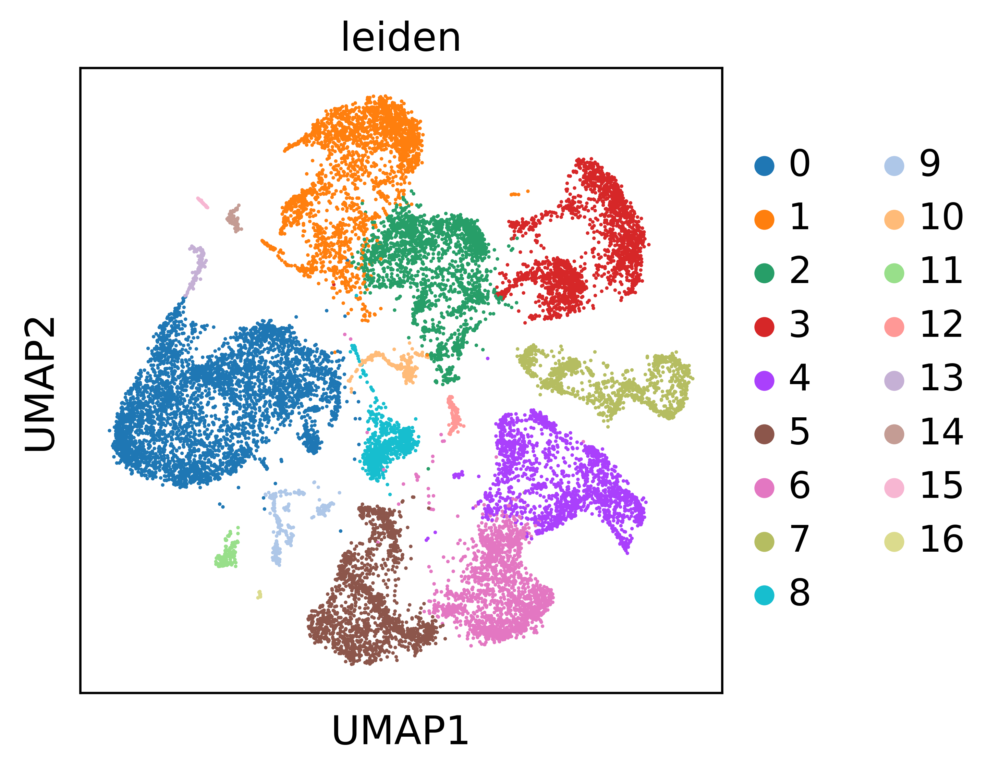

In [5]:
sc.pl.umap(adata, color ='leiden')

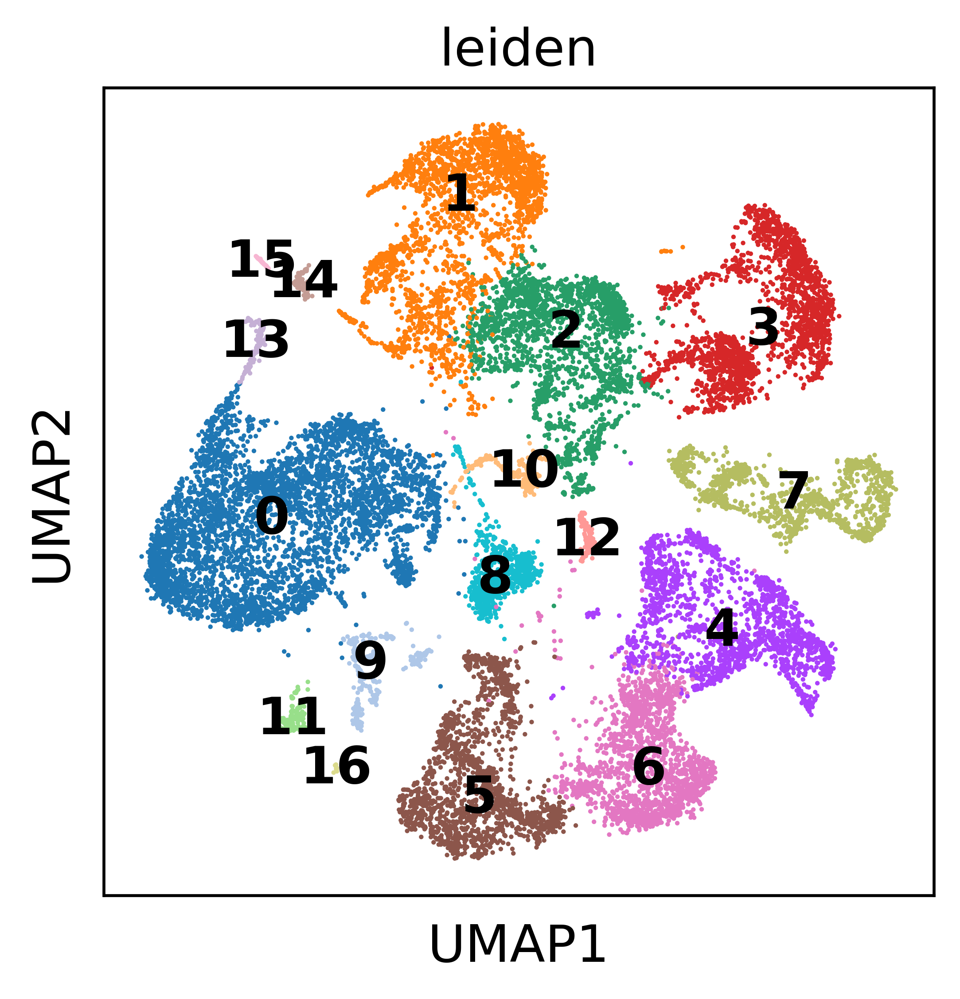

In [6]:
sc.pl.umap(adata, color ='leiden',legend_loc='on data')

In [6]:
adata

AnnData object with n_obs × n_vars = 19273 × 17566
    obs: 'Sample', 'batch', 'Conditions', 'leiden', 'Cell_typing_Panglao', 'umap_density_Conditions', 'umap_density_Sample'
    var: 'mean', 'std'
    uns: 'Cell_typing_Panglao_colors', 'Conditions_colors', 'Sample_colors', 'leiden', 'leiden_colors', 'leiden_sizes', 'neighbors', 'paga', 'rank_genes_groups', 'umap', 'umap_density_Conditions_params', 'umap_density_Sample_params'
    obsm: 'X_scanorama', 'X_umap'
    obsp: 'connectivities', 'distances'

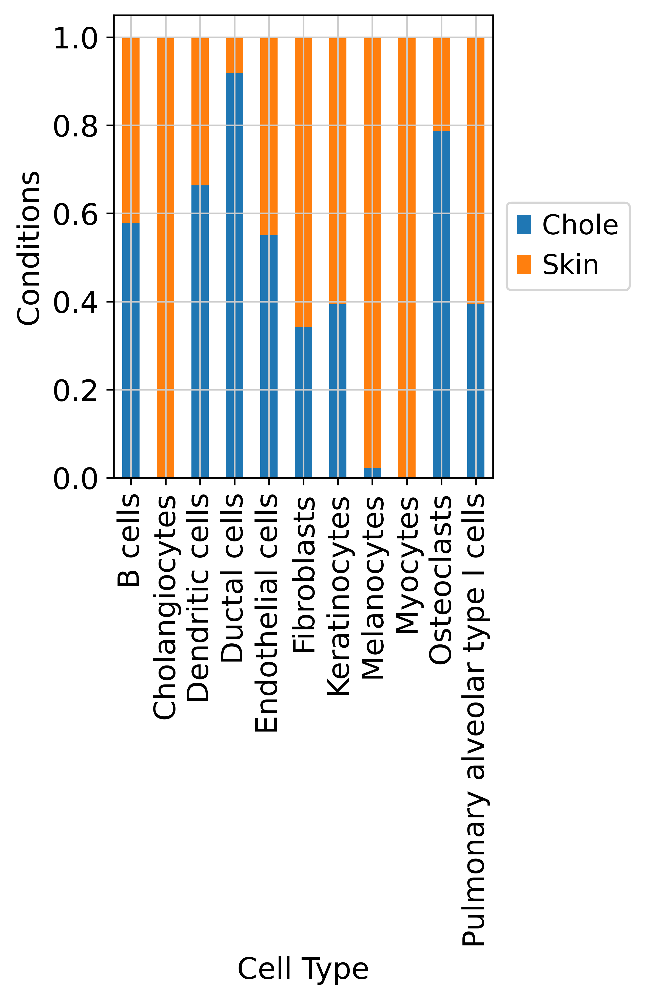

In [9]:
adata.obs.groupby(['Cell_typing_Panglao'])['Conditions'].value_counts(normalize = True).unstack().plot.bar(stacked=True)
ax = plt.subplot(111)
plt.ylabel('Conditions')
plt.xlabel('Cell Type')
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

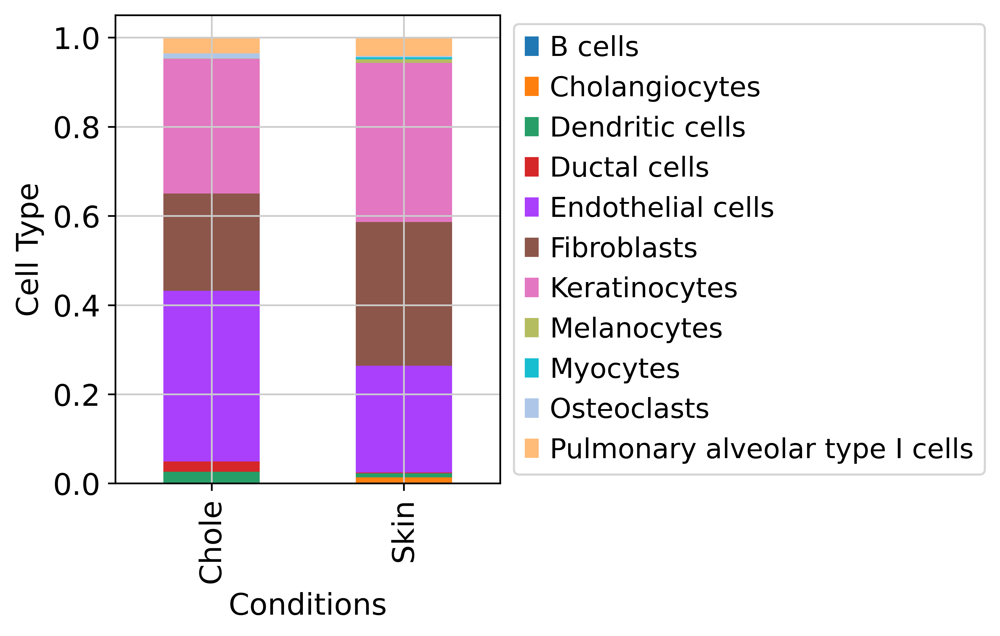

In [10]:
adata.obs.groupby(['Conditions'])['Cell_typing_Panglao'].value_counts(normalize = True).unstack().plot.bar(stacked=True)
ax = plt.subplot(111)
plt.ylabel('Cell Type')
plt.xlabel('Conditions')
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

In [19]:
Conditions = {
'GA23428':'Patient1',
'GA23429':'Patient1',
'GA18593':'Patient2',
'GA18594':'Patient2',
'GA11556':'Patient3',
'GA11557':'Patient3',
}

In [20]:
adata.obs['Cohort']=adata.obs['Sample'].map(Conditions)

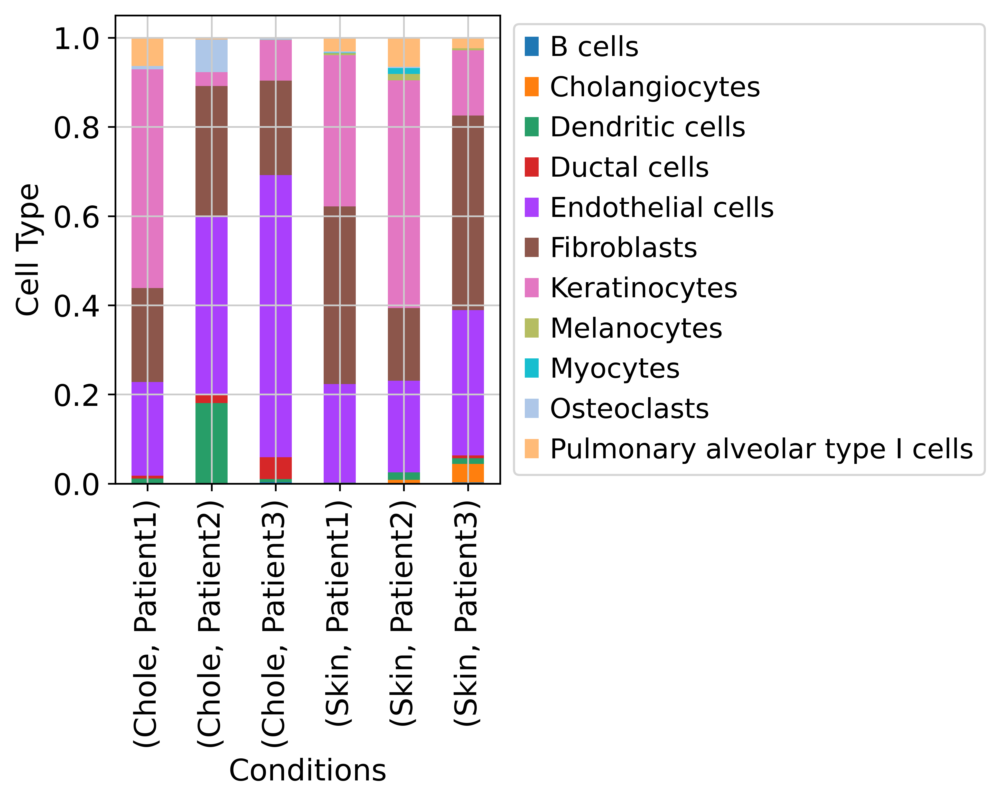

In [21]:
adata.obs.groupby(['Conditions','Cohort'])['Cell_typing_Panglao'].value_counts(normalize = True).unstack().plot.bar(stacked=True)
ax = plt.subplot(111)
plt.ylabel('Cell Type')
plt.xlabel('Conditions')
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

In [41]:
x = adata.obs.groupby(['Conditions','Cohort'])['Cell_typing_Panglao'].value_counts(normalize = True).unstack()

In [58]:
x.loc['Chole']["Fibroblasts"]

Cohort
Patient1    0.210898
Patient2    0.294118
Patient3    0.211313
Name: Fibroblasts, dtype: float64

(array([0, 1]),
 [Text(0, 0, 'cholesteatoa fibroblast'), Text(1, 0, 'skin fibroblast')])

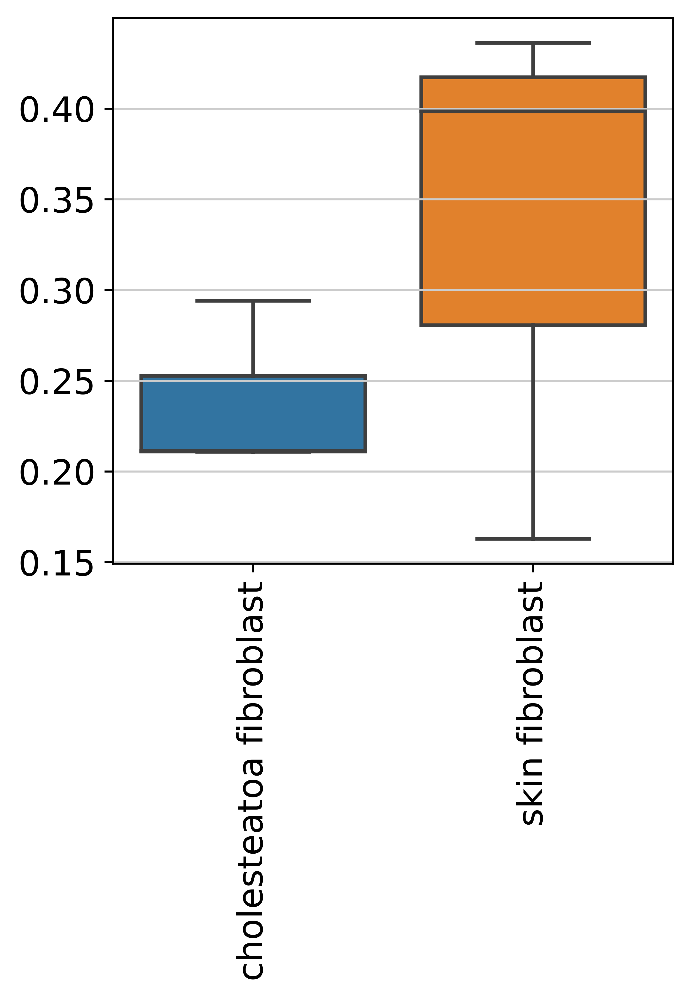

In [65]:

df=pd.DataFrame()
df['cholesteatoa fibroblast']=x.loc['Chole']["Fibroblasts"]
df['skin fibroblast']=x.loc['Skin']["Fibroblasts"]
sb.boxplot(df)
plt.xticks(rotation=90)


In [66]:
sp.stats.ttest_ind(df['cholesteatoa fibroblast'],df['skin fibroblast'])

Ttest_indResult(statistic=-1.0434077571424867, pvalue=0.3556669582949289)

In [60]:

df=pd.DataFrame()
df['Chole']=x.loc['Chole']["Fibroblasts"]
df['Skin']=x.loc['Skin']["Fibroblasts"]
sb.boxplot(df)

,Chole,Skin
Cohort,,
Patient1,0.210898,0.398356
Patient2,0.294118,0.162969
Patient3,0.211313,0.436247


<AxesSubplot:>

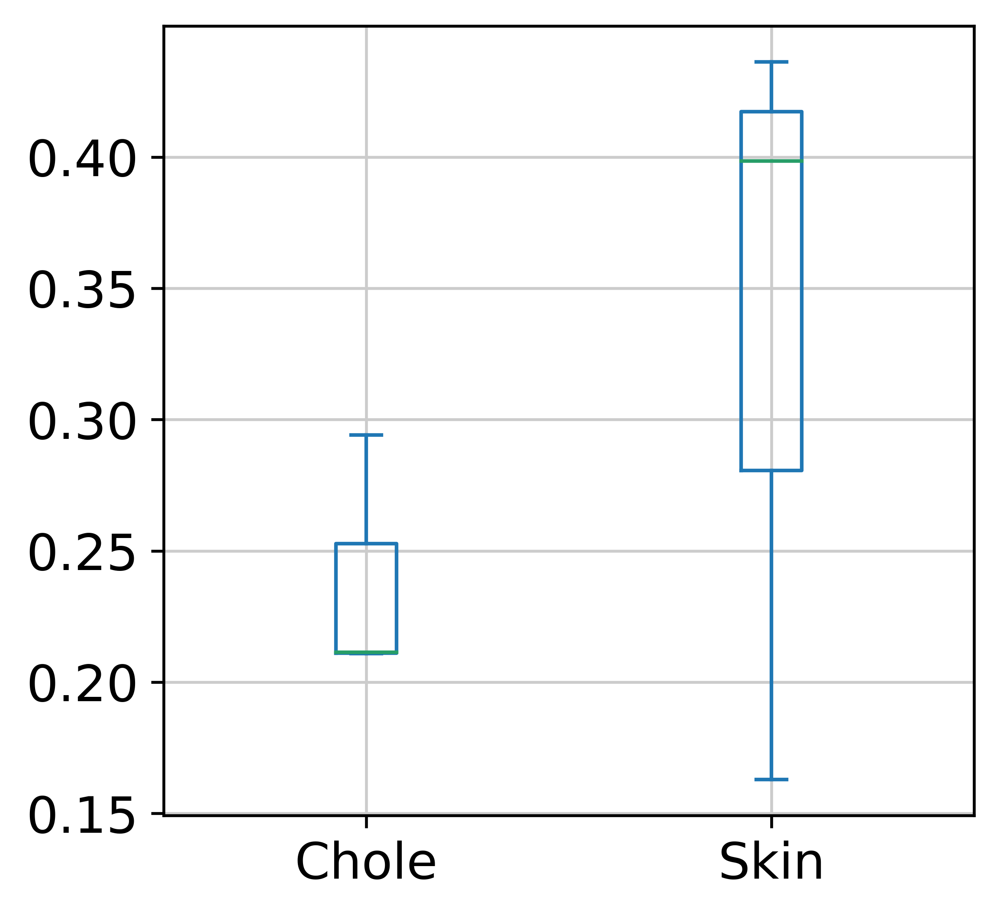

In [61]:
df.plot.box()

In [28]:
adata.obs.groupby(['Conditions','Cohort'])['Cell_typing_Panglao'].value_counts(normalize = True)

Conditions  Cohort    Cell_typing_Panglao            
Chole       Patient1  Keratinocytes                      0.490183
                      Fibroblasts                        0.210898
                      Endothelial cells                  0.210236
                      Pulmonary alveolar type I cells    0.063313
                      Dendritic cells                    0.011251
                                                           ...   
Skin        Patient3  Ductal cells                       0.006415
                      Melanocytes                        0.004812
                      B cells                            0.002807
                      Myocytes                           0.000000
                      Osteoclasts                        0.000000
Name: Cell_typing_Panglao, Length: 66, dtype: float64

In [35]:
sc.tl.embedding_density(adata, basis='umap', groupby='Conditions')

computing density on 'umap'
--> added
    'umap_density_Conditions', densities (adata.obs)
    'umap_density_Conditions_params', parameter (adata.uns)


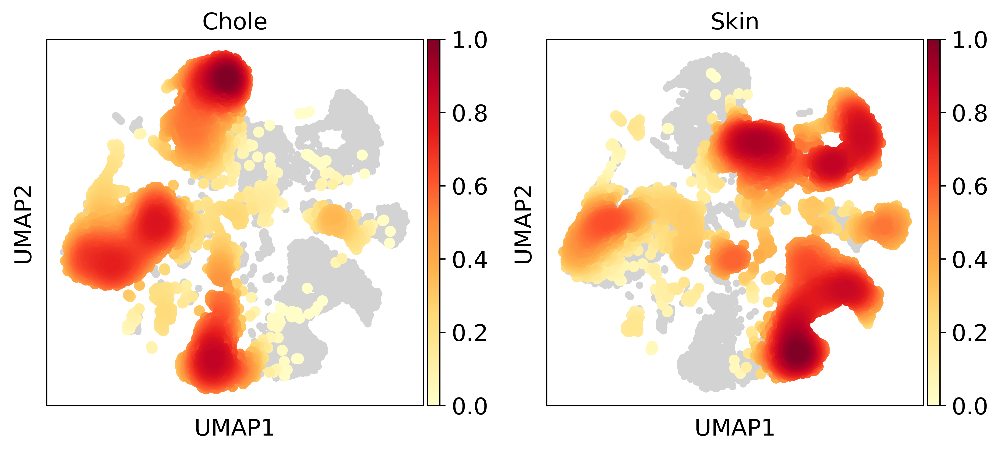

In [37]:
sc.pl.embedding_density(
    adata, basis='umap', key='umap_density_Conditions'
)

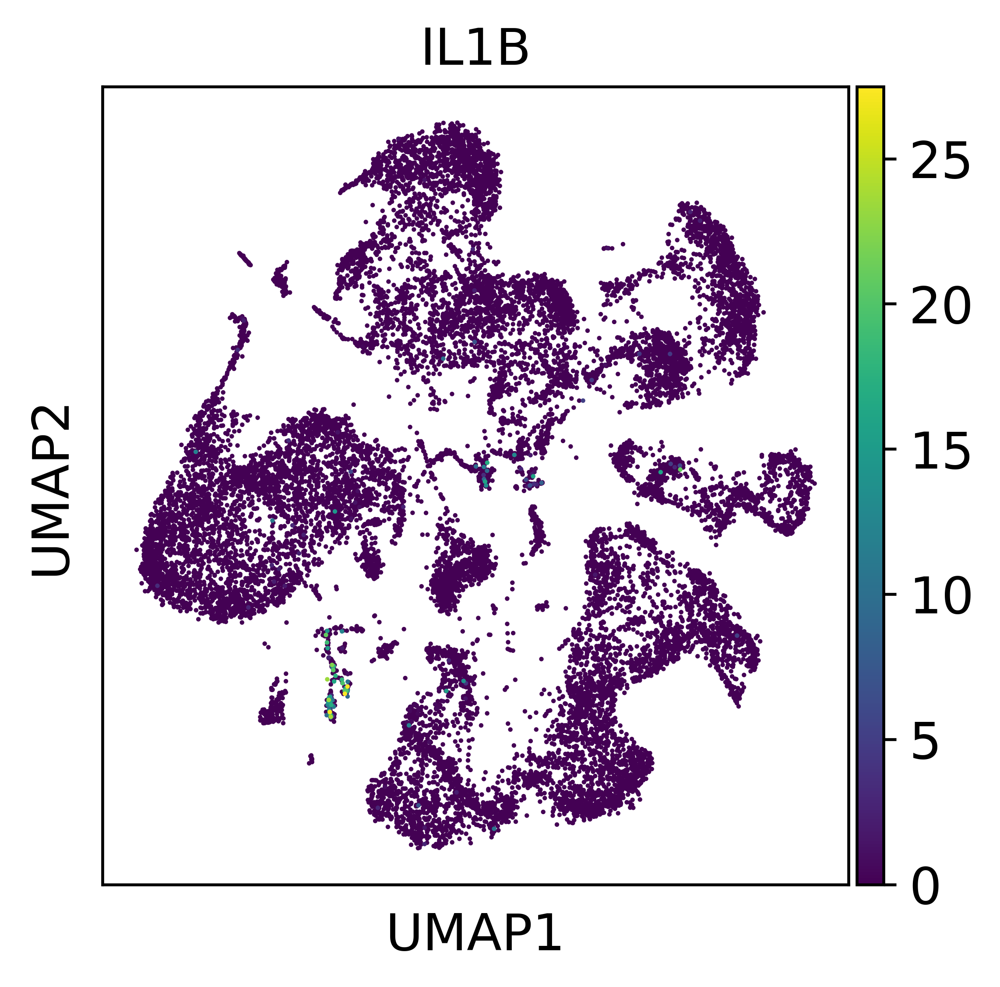

In [7]:
sc.pl.umap(adata, color ='IL1B', use_raw=False)

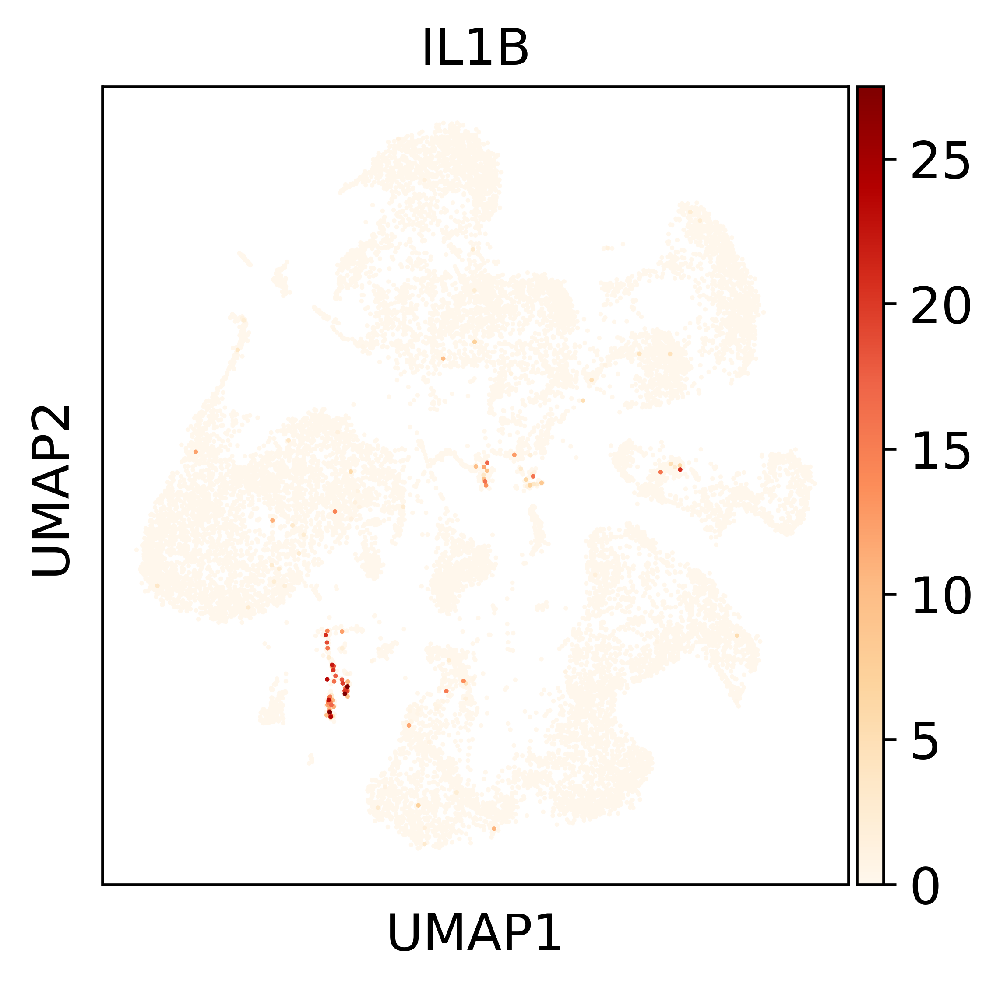

In [8]:
sc.pl.umap(adata, color ='IL1B', use_raw=False,cmap='OrRd')

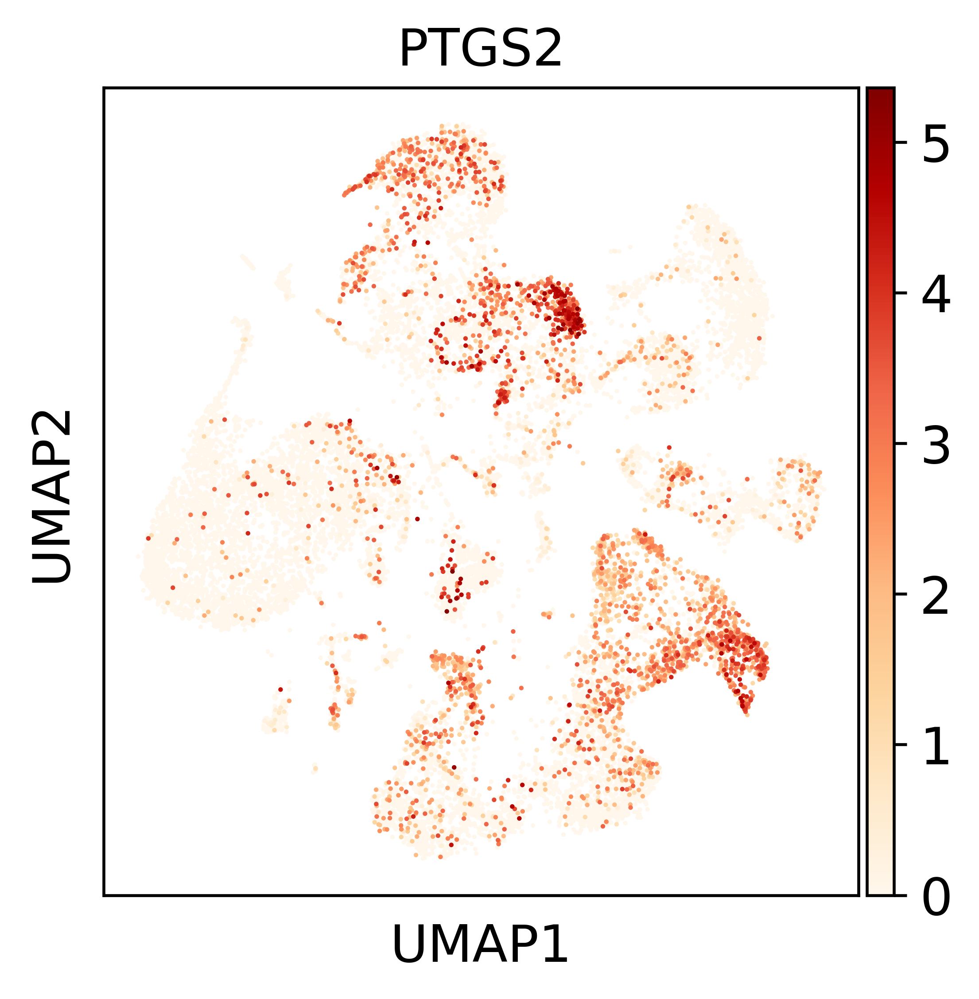

In [9]:
sc.pl.umap(adata, color ='PTGS2', use_raw=False,cmap='OrRd')

In [ ]:
sc.pl.umap(adata, color ='INHBA', use_raw=False)

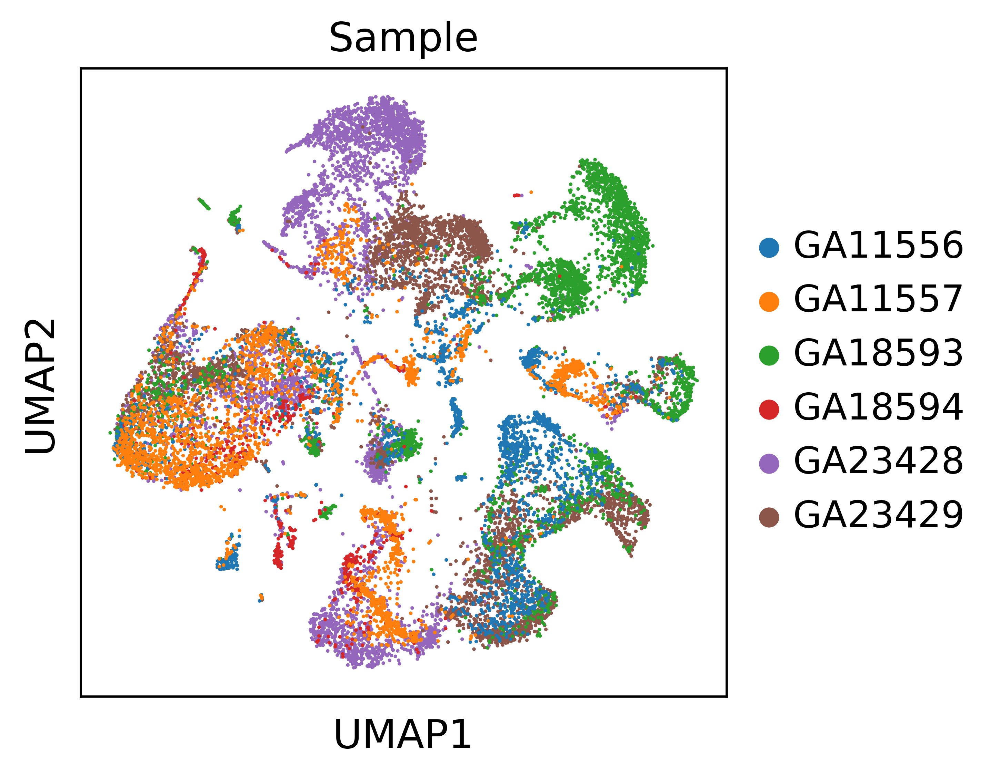

In [7]:
sc.pl.umap(adata, color ='Sample')

In [8]:
Conditions = {
'GA23428':'Patient1',
'GA23429':'Patient1',
'GA18593':'Patient2',
'GA18594':'Patient2',
'GA11556':'Patient3',
'GA11557':'Patient3',
}

In [9]:
adata.obs['Cohort']=adata.obs['Sample'].map(Conditions)

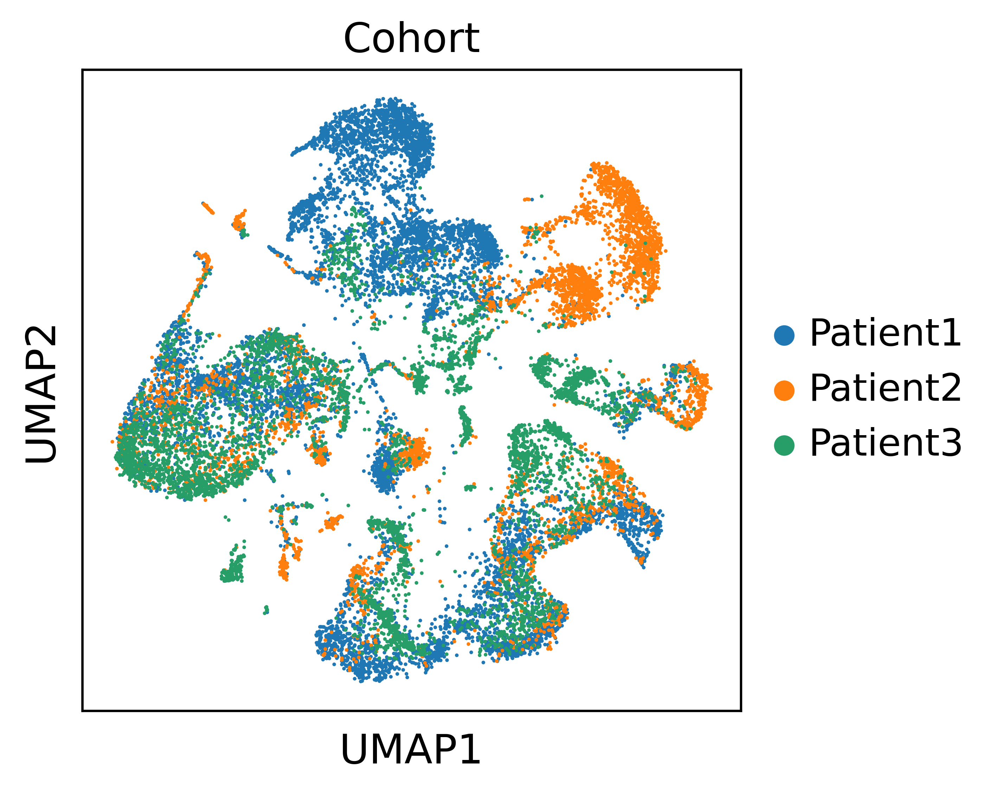

In [10]:
sc.pl.umap(adata, color ='Cohort')

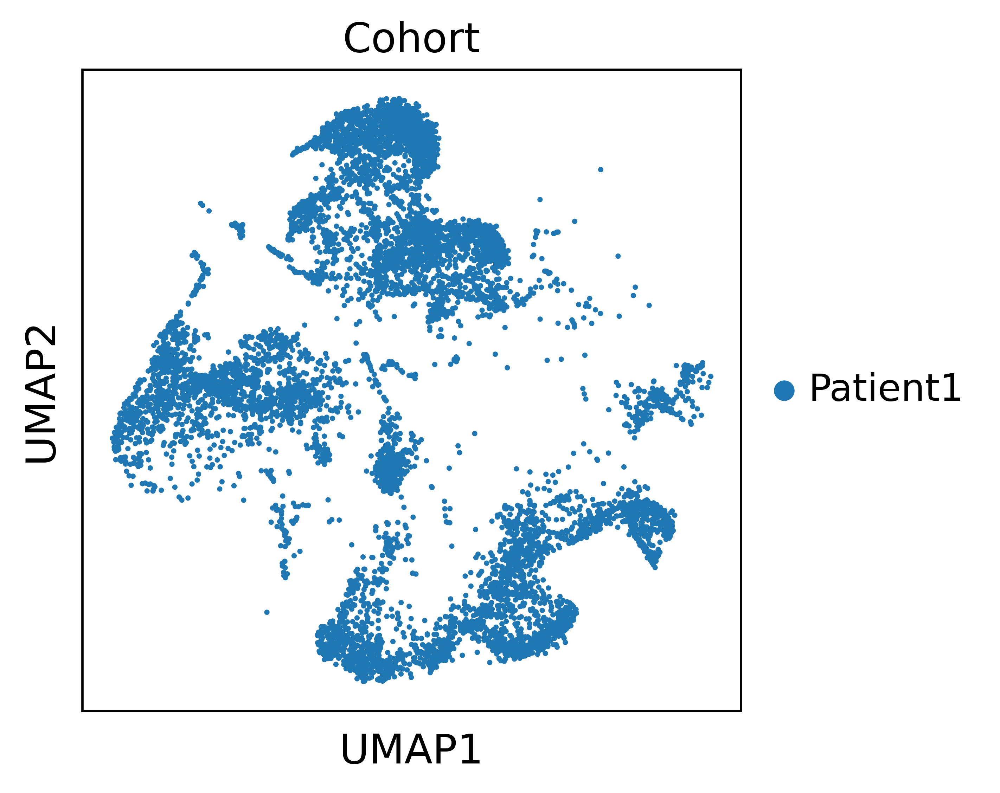

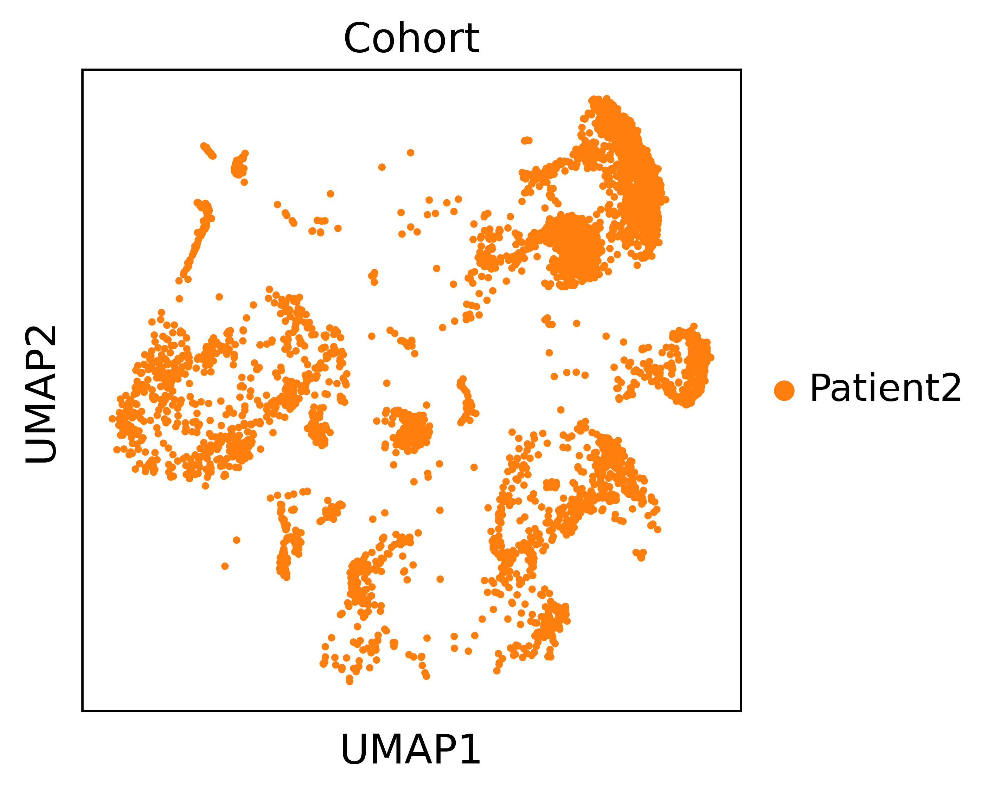

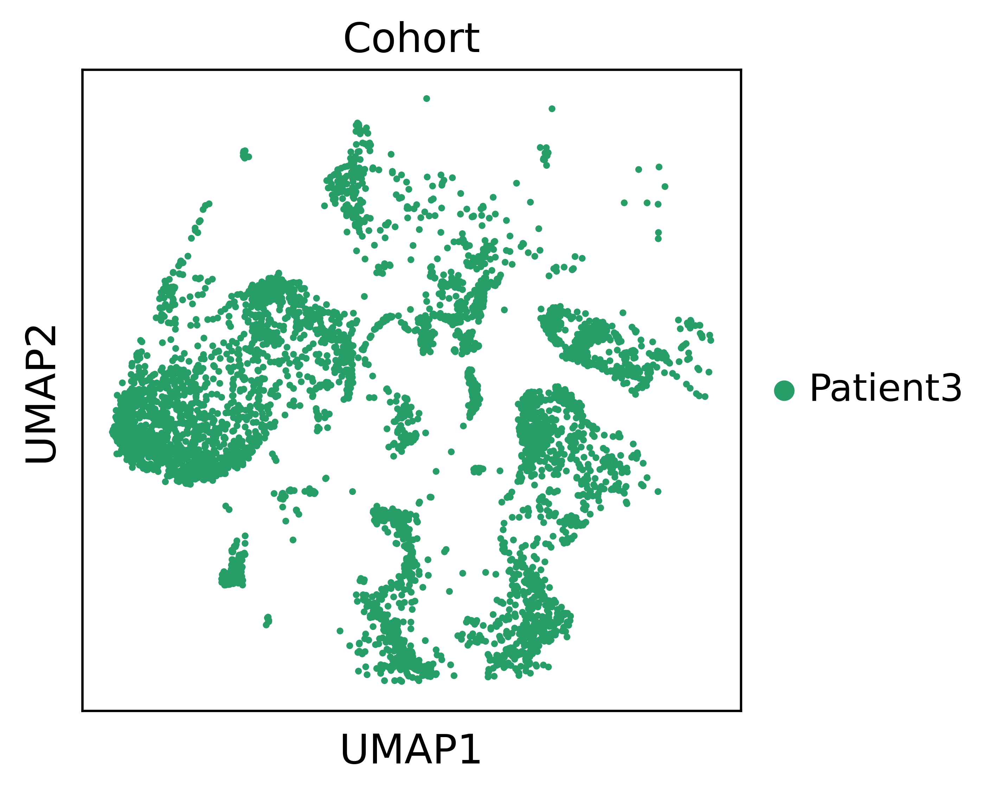

In [11]:
for c in adata.obs.Cohort.unique():
    sc.pl.umap(adata[adata.obs.Cohort==c], color ='Cohort')

In [12]:
adata

AnnData object with n_obs × n_vars = 19273 × 17566
    obs: 'Sample', 'batch', 'Conditions', 'leiden', 'Cell_typing_Panglao', 'umap_density_Conditions', 'umap_density_Sample', 'Cohort'
    var: 'mean', 'std'
    uns: 'Cell_typing_Panglao_colors', 'Conditions_colors', 'Sample_colors', 'leiden', 'leiden_colors', 'leiden_sizes', 'neighbors', 'paga', 'rank_genes_groups', 'umap', 'umap_density_Conditions_params', 'umap_density_Sample_params', 'Cohort_colors'
    obsm: 'X_scanorama', 'X_umap'
    obsp: 'connectivities', 'distances'

In [13]:
adata.obs['Cell_typing_Panglao'].value_counts()

Keratinocytes                      6419
Endothelial cells                  5808
Fibroblasts                        5346
Pulmonary alveolar type I cells     747
Dendritic cells                     312
Ductal cells                        211
Cholangiocytes                      138
Osteoclasts                         127
Melanocytes                          91
Myocytes                             55
B cells                              19
Name: Cell_typing_Panglao, dtype: int64

In [14]:
adata

AnnData object with n_obs × n_vars = 19273 × 17566
    obs: 'Sample', 'batch', 'Conditions', 'leiden', 'Cell_typing_Panglao', 'umap_density_Conditions', 'umap_density_Sample', 'Cohort'
    var: 'mean', 'std'
    uns: 'Cell_typing_Panglao_colors', 'Conditions_colors', 'Sample_colors', 'leiden', 'leiden_colors', 'leiden_sizes', 'neighbors', 'paga', 'rank_genes_groups', 'umap', 'umap_density_Conditions_params', 'umap_density_Sample_params', 'Cohort_colors'
    obsm: 'X_scanorama', 'X_umap'
    obsp: 'connectivities', 'distances'

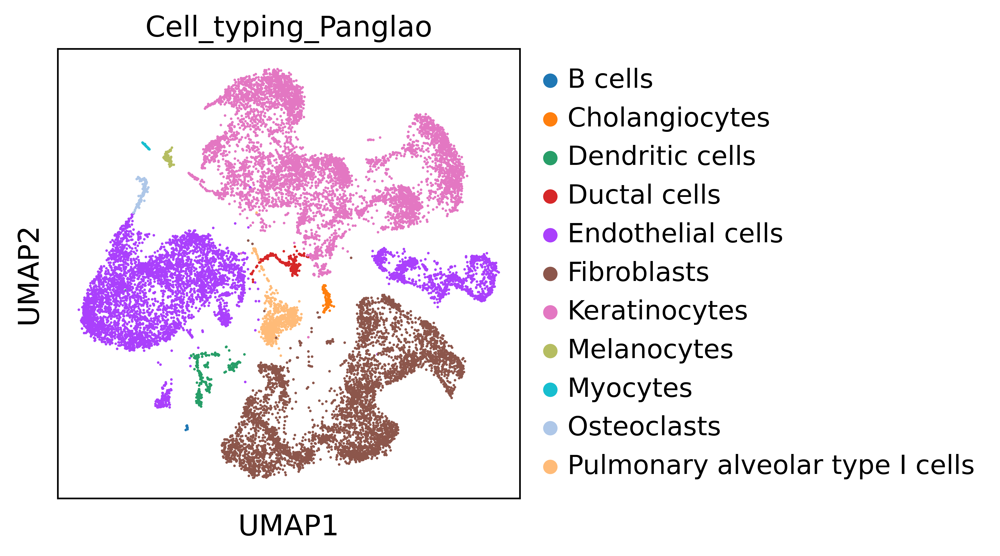

In [15]:
sc.pl.umap(adata, color ='Cell_typing_Panglao')

In [16]:
sub = adata[adata.obs['Cell_typing_Panglao']=='Fibroblasts'].copy()

In [17]:

del sub.uns['leiden_colors']
del sub.uns['paga']

running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


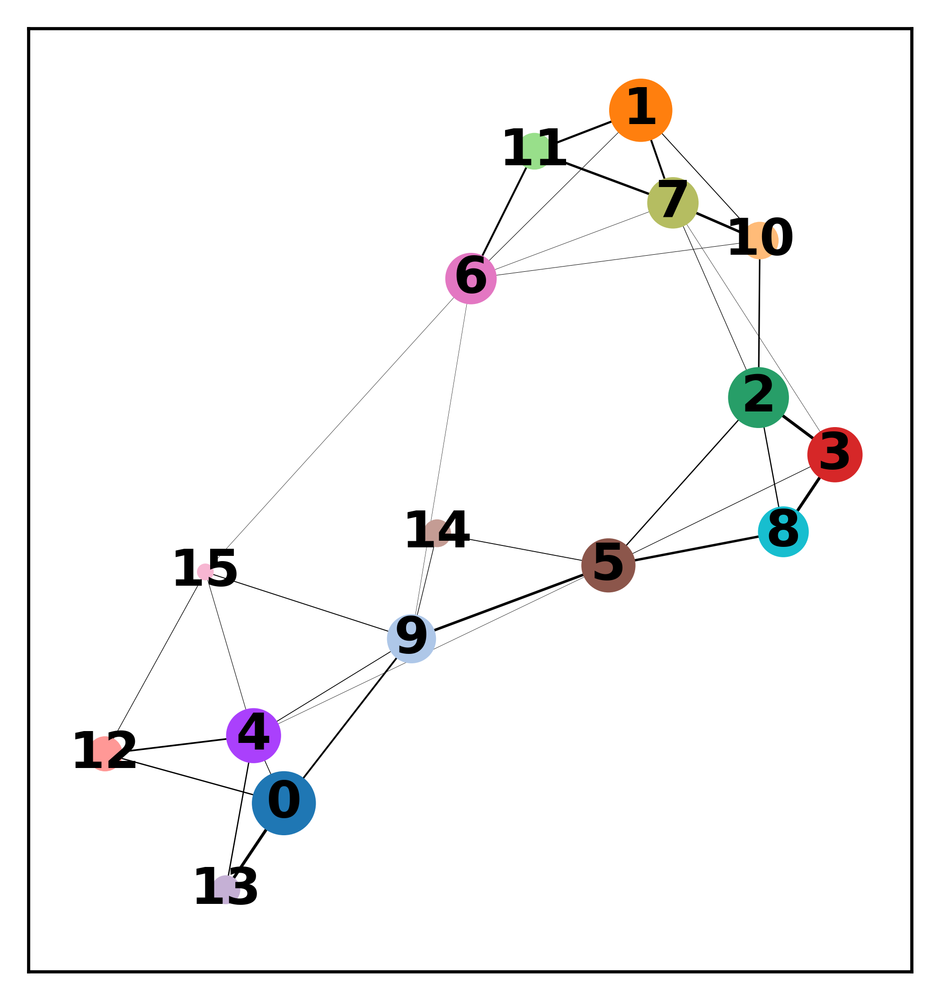

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


In [ ]:
sc.tl.leiden(sub)
sc.tl.paga(sub,groups='leiden')

sc.pl.paga(sub,node_size_power= 1.0,threshold=0.1 ,edge_width_scale = 0.1) 
sc.tl.umap(sub,  init_pos=sc.tl._utils.get_init_pos_from_paga(sub), maxiter=100,min_dist=0.1, spread=4.0)
sc.pl.umap(sub,color='leiden')

In [ ]:
sc.pl.umap(sub,color='Conditions')

In [ ]:
sub.write(out_path+'/Fibroblasts_sub_0602.h5ad')

In [ ]:
All_annotation = list(sub.obs.columns)
sub.obs.index.name = 'cell'
sc.external.exporting.cellbrowser(sub, 'Shimitu_sub_0602', 'Fibroblasts_0602', annot_keys=All_annotation, cluster_field='leiden',html_dir='Cell_browser_Shimitu')

In [ ]:
from pyBCS import scanpy2bcs
scanpy2bcs.format_data(out_path+'/Fibroblasts_sub_0602.h5ad', out_path+'/Fibroblasts_sub_0602.bcs',
                        input_format="h5ad", graph_based="leiden")

In [ ]:

sc.tl.rank_genes_groups(sub, groupby='leiden',use_raw=False)
rank_genes = pd.DataFrame(sub.uns['rank_genes_groups']['names'])
rank_pavlues = pd.DataFrame(sub.uns['rank_genes_groups']['pvals'])
rank_pavlues.rename(columns=lambda x: x+'_pvals', inplace=True)
rank_fold = pd.DataFrame(sub.uns['rank_genes_groups']['logfoldchanges'])
rank_fold.rename(columns=lambda x: x+'_logfoldchanges', inplace=True)
pd.concat([rank_genes, rank_pavlues,rank_fold], axis=1, join='inner').to_csv(out_path+'/Fibroblasts_By_subclusters_0602.csv')

sc.tl.rank_genes_groups(sub, groupby='Conditions',reference='Skin',use_raw=False)
sc.pl.rank_genes_groups(sub, groupby='Conditions',reference='Skin',use_raw=False)
rank_genes = pd.DataFrame(sub.uns['rank_genes_groups']['names'])
rank_pavlues = pd.DataFrame(sub.uns['rank_genes_groups']['pvals'])
rank_pavlues.rename(columns=lambda x: x+'_pvals', inplace=True)
rank_fold = pd.DataFrame(sub.uns['rank_genes_groups']['logfoldchanges'])
rank_fold.rename(columns=lambda x: x+'_logfoldchanges', inplace=True)
pd.concat([rank_genes, rank_pavlues,rank_fold], axis=1, join='inner').to_csv(out_path+'/Fibroblasts_By_conditions_0602.csv')

In [ ]:
top_15_Keratinocytes = list(set(sum(rank_genes.head(15).values.tolist(),[])))

In [ ]:
sc.pl.stacked_violin(sub,top_15_Keratinocytes,groupby='Conditions')

In [ ]:
for g in top_15_Keratinocytes:
    sc.pl.violin(sub,g,groupby='Conditions')

In [ ]:
sub = adata[adata.obs['Cell_typing_Panglao']=='Endothelial cells'].copy()

In [ ]:
sc.tl.rank_genes_groups(sub, groupby='Conditions',reference='Skin',use_raw=False)

In [ ]:
rank_genes = pd.DataFrame(sub.uns['rank_genes_groups']['names'])
rank_pavlues = pd.DataFrame(sub.uns['rank_genes_groups']['pvals'])
rank_pavlues.rename(columns=lambda x: x+'_pvals', inplace=True)
rank_fold = pd.DataFrame(sub.uns['rank_genes_groups']['logfoldchanges'])
rank_fold.rename(columns=lambda x: x+'_logfoldchanges', inplace=True)
pd.concat([rank_genes, rank_pavlues,rank_fold], axis=1, join='inner').to_csv(out_path+'/Endothelial_Bycondition_1220.csv')

In [ ]:
sc.pl.rank_genes_groups(sub, groupby='Conditions',reference='Skin',use_raw=False)

In [ ]:
x =  pd.DataFrame(sub.uns['rank_genes_groups']['names'])
y =  pd.DataFrame(sub.uns['rank_genes_groups']['scores'])
z =  pd.DataFrame(sub.uns['rank_genes_groups']['logfoldchanges'])
gene_table = pd.concat([x,y,z], axis=1, join='inner').head(10)
gene_table.columns =['genes','scores','logfoldchanges']
gene_table['scores'] = gene_table['scores'].astype(int)
gene_table.index =gene_table['genes']
gene_table.plot(kind="bar")
sc.pl.rank_genes_groups(sub, groupby='Conditions',reference='Skin',use_raw=False)

In [ ]:
top_15_Endothelial = list(set(sum(rank_genes.head(15).values.tolist(),[])))

In [ ]:
sc.pl.stacked_violin(sub,top_15_Endothelial,groupby='Conditions')

In [ ]:
for g in top_15_Endothelial:
    sc.pl.violin(sub,g,groupby='Conditions')

In [ ]:
sub = adata[adata.obs['Cell_typing_Panglao']=='Fibroblasts'].copy()
sc.tl.rank_genes_groups(sub, groupby='Conditions',reference='Skin',use_raw=False)
rank_genes = pd.DataFrame(sub.uns['rank_genes_groups']['names'])
rank_pavlues = pd.DataFrame(sub.uns['rank_genes_groups']['pvals'])
rank_pavlues.rename(columns=lambda x: x+'_pvals', inplace=True)
rank_fold = pd.DataFrame(sub.uns['rank_genes_groups']['logfoldchanges'])
rank_fold.rename(columns=lambda x: x+'_logfoldchanges', inplace=True)
pd.concat([rank_genes, rank_pavlues,rank_fold], axis=1, join='inner').to_csv(out_path+'/Fibroblasts_Bycondition_1220.csv')
x =  pd.DataFrame(sub.uns['rank_genes_groups']['names'])
y =  pd.DataFrame(sub.uns['rank_genes_groups']['scores'])
z =  pd.DataFrame(sub.uns['rank_genes_groups']['logfoldchanges'])
gene_table = pd.concat([x,y,z], axis=1, join='inner')

gene_table.columns =['genes','scores','logfoldchanges']
gene_table['scores'] = gene_table['scores'].astype(int)
gene_table.index =gene_table['genes']
gene_table=gene_table[gene_table['genes'].isin(['IGF2','SFRP2','INHBA','PRSS23','EGFL6','INHBB','INHA'])]
gene_table.plot(kind="bar")
sc.pl.rank_genes_groups(sub, groupby='Conditions',reference='Skin',use_raw=False)

In [ ]:
gene_table[gene_table['genes'].isin(['IGF2','SFRP2','INHBA','PRSS23','EGFL6'])]

In [ ]:
top_15_Fibroblasts = list(set(sum(rank_genes.head(15).values.tolist(),[])))

In [ ]:
sc.pl.stacked_violin(sub,top_15_Fibroblasts,groupby='Conditions')

In [ ]:
for g in top_15_Fibroblasts:
    sc.pl.violin(sub,g,groupby='Conditions')

In [ ]:
sc.pl.umap(adata, color ='INHBA', use_raw=False,cmap='OrRd')

In [ ]:
sc.pl.umap(adata, color =['IGF2','SFRP2','INHBA','PRSS23','EGFL6','INHBB'], use_raw=False,cmap='OrRd')

In [ ]:
sc.pl.umap(adata, color ='INHA',cmap='OrRd')